> ## Uber Data Analysis 

> ### Data Loading

In [1]:
import pandas as pd 
import matplotlib.pyplot as plt 
import numpy as np 
import seaborn as sns 
import os

In [2]:
files = os.listdir(r'C:\Users\FiBer-Tech\Desktop\practice\uber_data\uber-pickups-in-new-york-city')[-7:]
files.remove('uber-raw-data-janjune-15.csv')

In [3]:
path = r'C:\Users\FiBer-Tech\Desktop\practice\uber_data\uber-pickups-in-new-york-city'
final = pd.DataFrame()
for file in files:
    df = pd.read_csv(path + '/' + file , encoding= 'utf-8')
    final = pd.concat([final,df])
    
    

In [4]:
final.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


> ### Data Preparation.


In [5]:
df = final.copy()

In [6]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


In [8]:
# convert date/time column from object to datetime.
df['Date/Time'] = pd.to_datetime(df['Date/Time'])

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   Date/Time  datetime64[ns]
 1   Lat        float64       
 2   Lon        float64       
 3   Base       object        
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 173.0+ MB


In [10]:
df['weekday']=df['Date/Time'].dt.day_name()
df['day']=df['Date/Time'].dt.day
df['minute']=df['Date/Time'].dt.minute
df['month']=df['Date/Time'].dt.month
df['hour']=df['Date/Time'].dt.hour

In [11]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


> #### Statistical Summary Of Our Data.

In [12]:
df.describe()

,Lat,Lon,day,minute,month,hour
count,4.534327e+06,4.534327e+06,4.534327e+06,4.534327e+06,4.534327e+06,4.534327e+06
mean,4.073926e+01,-7.397302e+01,1.594337e+01,2.940071e+01,6.828703e+00,1.421831e+01
std,3.994991e-02,5.726670e-02,8.744902e+00,1.732238e+01,1.703810e+00,5.958759e+00
min,3.965690e+01,-7.492900e+01,1.000000e+00,0.000000e+00,4.000000e+00,0.000000e+00
25%,4.072110e+01,-7.399650e+01,9.000000e+00,1.400000e+01,5.000000e+00,1.000000e+01
50%,4.074220e+01,-7.398340e+01,1.600000e+01,2.900000e+01,7.000000e+00,1.500000e+01
75%,4.076100e+01,-7.396530e+01,2.300000e+01,4.400000e+01,8.000000e+00,1.900000e+01
max,4.211660e+01,-7.206660e+01,3.100000e+01,5.900000e+01,9.000000e+00,2.300000e+01


> #### Analysis journey By WeekDay.
**we found that thursday has the most number of Trips.**

In [13]:
df['weekday'].value_counts()


Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: weekday, dtype: int64

[Text(0.5, 0, 'Day'),
 Text(0, 0.5, 'Number Of Trips'),
 Text(0.5, 1.0, 'Analysis of Trips Per WeekDay')]

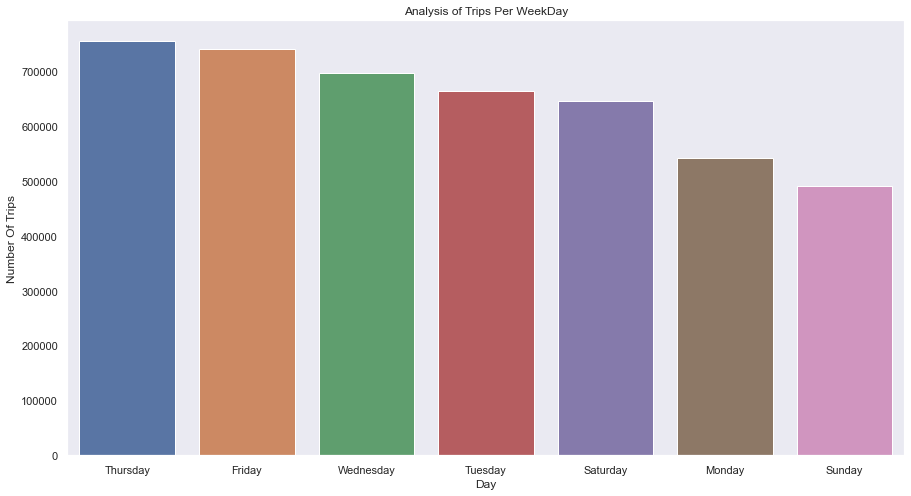

In [14]:
plt.figure(figsize=(15,8))
sns.set_theme(style= 'dark')
ax = sns.barplot(x=df['weekday'].value_counts().index, y=df['weekday'].value_counts())
ax.set(xlabel = 'Day', ylabel = 'Number Of Trips', title = 'Analysis of Trips Per WeekDay',)



> #### Analysis Journey Per Hour.
**we found the number of trips increase in evening.**

[Text(0.5, 0, 'Hour'),
 Text(0, 0.5, 'Number Of Trips'),
 Text(0.5, 1.0, 'Analysis Of Trips Per Hour')]

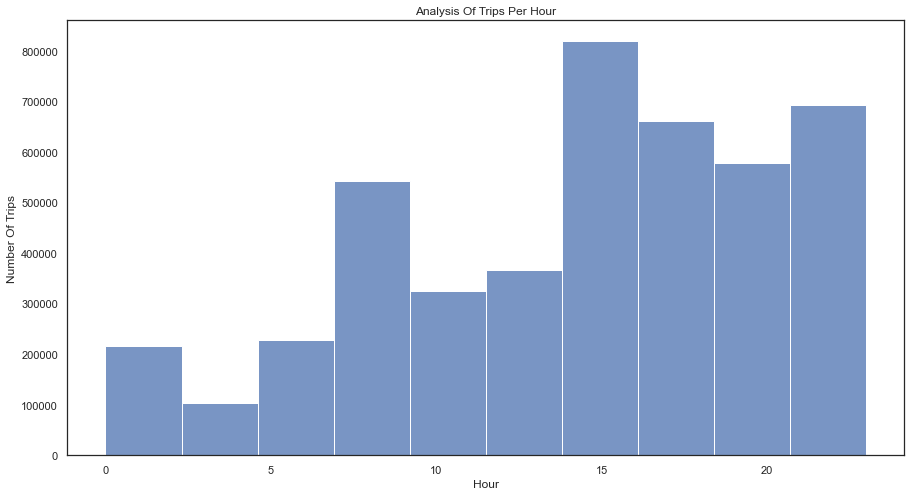

In [15]:
plt.figure(figsize=(15, 8))
sns.set_theme(style='white')
ax = sns.histplot(data=df['hour'], bins=10)
ax.set(xlabel='Hour', ylabel = 'Number Of Trips', title = 'Analysis Of Trips Per Hour')


> #### Analysis number of trips in each month based on hour.
**we conclude that trips increasing in the evening in all months**

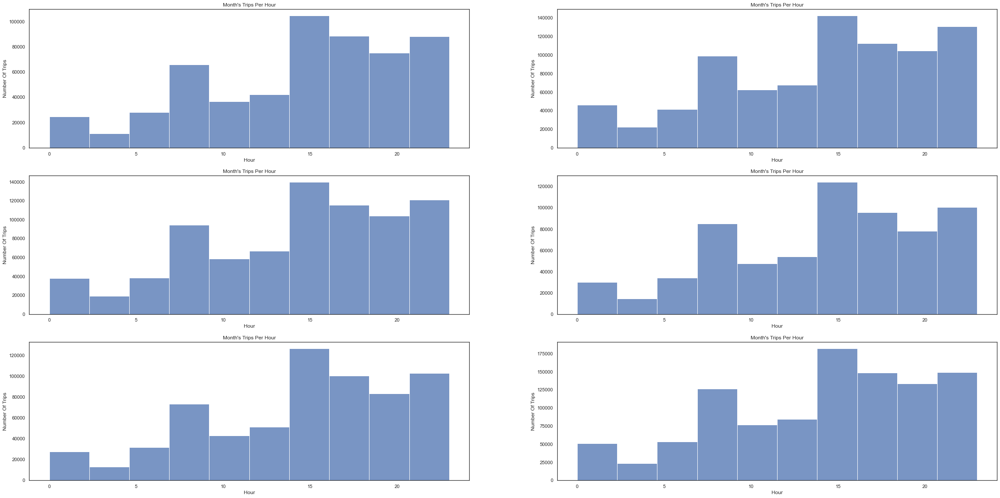

In [20]:
plt.figure(figsize=(40,20))
for i, month in enumerate(df['month'].unique()):
    plt.subplot(3, 2, i+1)
    ax = sns.histplot(df[df['month']== month]['hour'], bins=10)
    ax.set(xlabel = 'Hour', ylabel = 'Number Of Trips' , title = 'Month\'s Trips Per Hour')

> #### Analysis of which month have the most trips?
**we conclude the Month: 9 have the most trips.**

In [28]:
df.groupby('month')['Date/Time'].count()


month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: Date/Time, dtype: int64

[Text(0.5, 0, 'Month'),
 Text(0, 0.5, 'Number OF Trips'),
 Text(0.5, 1.0, 'Trips Per Each Month')]

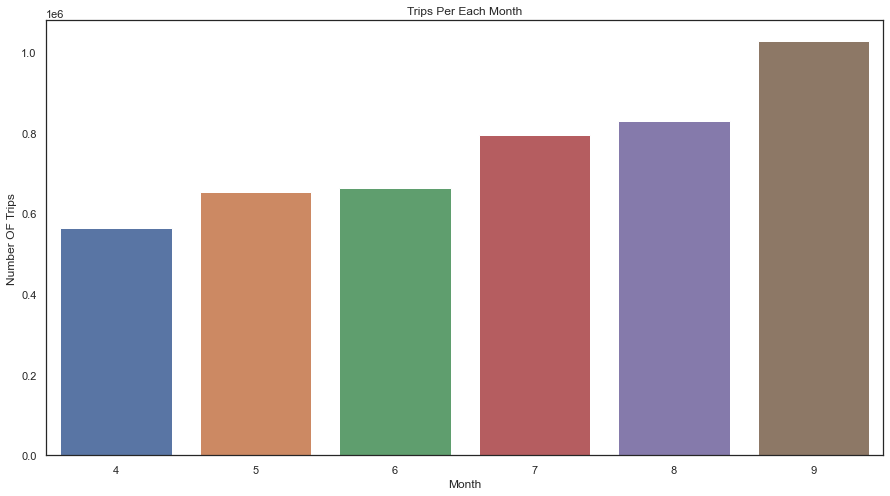

In [30]:
plt.figure(figsize=(15, 8))
ax = sns.barplot(x=df.groupby('month')['Date/Time'].count().index,
                y=df.groupby('month')['Date/Time'].count())
ax.set(xlabel = 'Month', ylabel = 'Number OF Trips', title = 'Trips Per Each Month')

> #### Analysis of journey of each day

[Text(0.5, 0, 'date of the month'),
 Text(0, 0.5, 'Total Journeys'),
 Text(0.5, 1.0, 'Journeys by Month Day')]

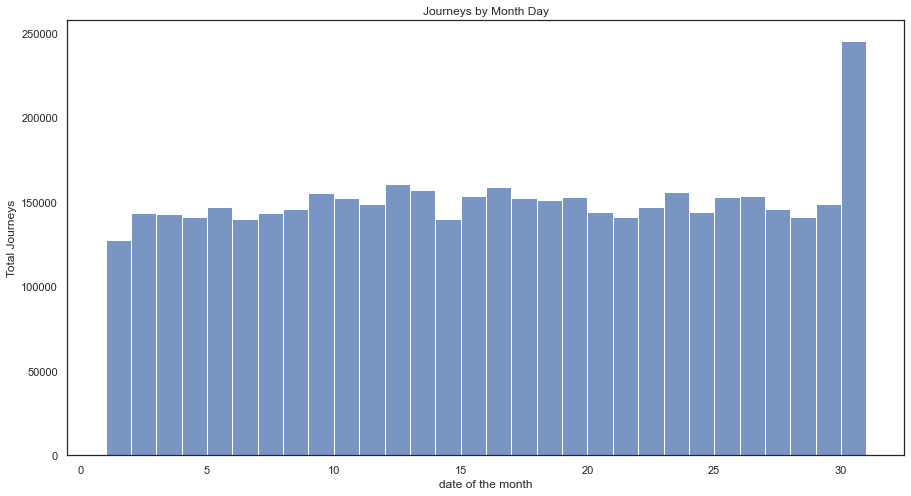

In [55]:
plt.figure(figsize=(15,8))
ax = sns.histplot(df['day'], bins=30 )
ax.set(xlabel = 'date of the month', ylabel = 'Total Journeys', title = 'Journeys by Month Day')

> #### Analysis of Total rides month wise.

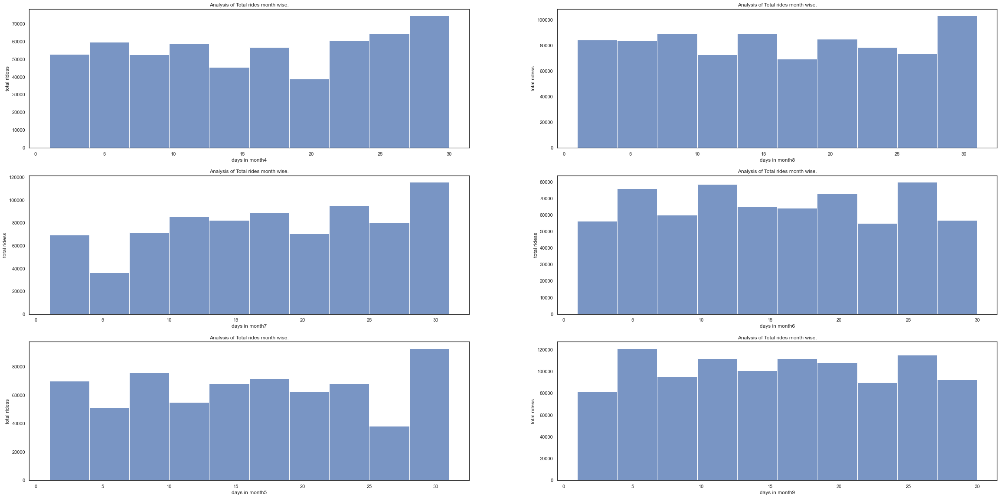

In [56]:
plt.figure(figsize=(40,20))
for i, month in enumerate(df['month'].unique()):
    plt.subplot(3, 2, i+1)
    ax = sns.histplot(df[df['month']== month]['day'], bins=10)
    ax.set(xlabel = 'days in month{}'.format(month), ylabel = 'total ridess' , title = 'Analysis of Total rides month wise.')

> #### Analysis Of Rush in Hours.

Text(0.5, 1.0, 'Hours Of Day VS Latitude Of Passenger.')

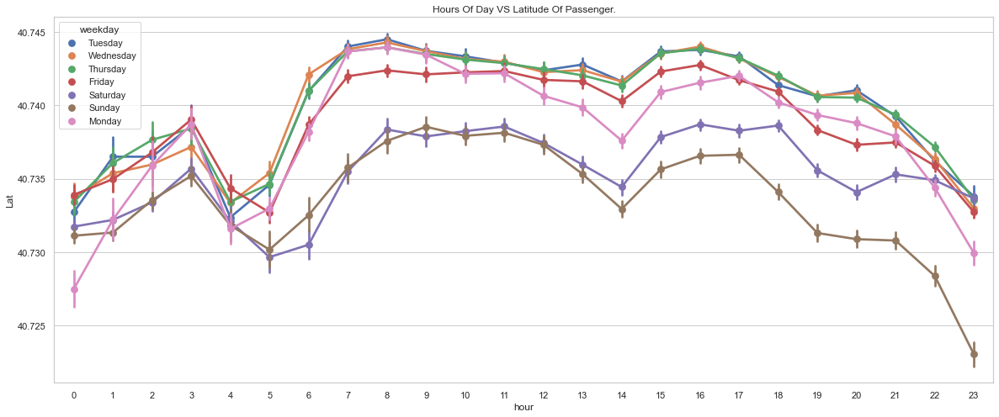

In [65]:
plt.figure(figsize=(20,8))
ax = sns.pointplot(x='hour', y='Lat', data=df, hue='weekday')
ax.set_title('Hours Of Day VS Latitude Of Passenger.')

> #### analyse which base number gets popular by month name.
**we conclude that Base B02617 has increased number of trips**

In [66]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


In [67]:
df.groupby(['Base','month'])['Date/Time'].count()

Base    month
B02512  4         35536
        5         36765
        6         32509
        7         35021
        8         31472
        9         34370
B02598  4        183263
        5        260549
        6        242975
        7        245597
        8        220129
        9        240600
B02617  4        108001
        5        122734
        6        184460
        7        310160
        8        355803
        9        377695
B02682  4        227808
        5        222883
        6        194926
        7        196754
        8        173280
        9        197138
B02764  4          9908
        5          9504
        6          8974
        7          8589
        8         48591
        9        178333
Name: Date/Time, dtype: int64

In [68]:
base=df.groupby(['Base','month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<AxesSubplot:xlabel='month', ylabel='Date/Time'>

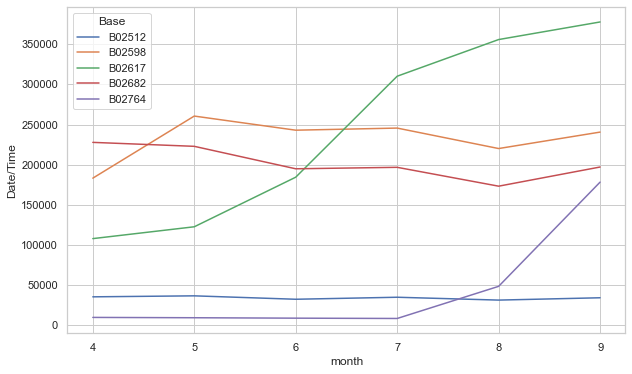

In [69]:
plt.figure(figsize=(10,6))
sns.lineplot(x='month',y='Date/Time',hue='Base',data=base)

> # Cross Analysis
_We observe that the number of trips increases each month, we can say that from April to September 2014, Uber was in a continuous improvement process._


>### Create Pivot Table And HeatMap

In [70]:
def count_rows(rows):
    return len(rows)

In [71]:
by_cross = df.groupby(['weekday','hour']).apply(count_rows)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [72]:
pivot=by_cross.unstack()
pivot

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='hour', ylabel='weekday'>

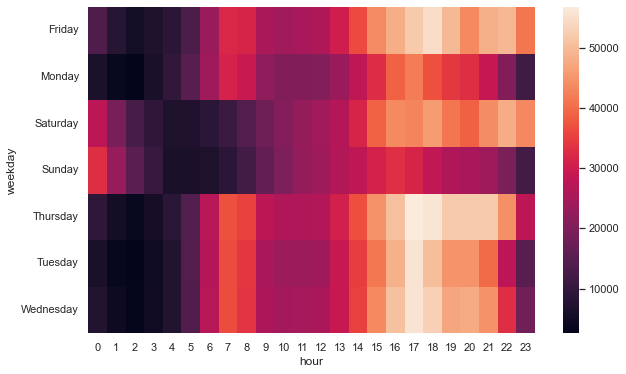

In [73]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot, annot=False)

In [74]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


> ##### I think automate visualization will do better.

In [80]:
def heatmap(col1,col2):
    by_cross = df.groupby([col1,col2]).apply(lambda x:len(x))
    pivot=by_cross.unstack()
    plt.figure(figsize=(15,8))
    return sns.heatmap(pivot,annot=False)

<AxesSubplot:xlabel='hour', ylabel='day'>

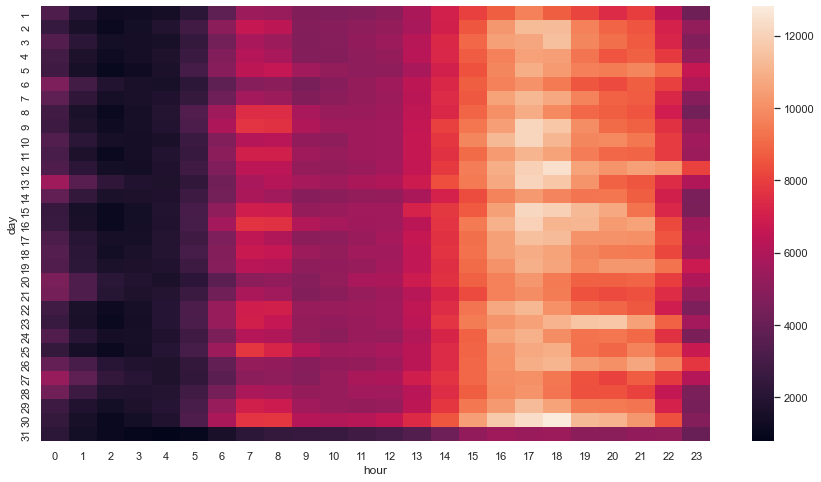

In [81]:
## validating above Analysis through Heatmap
heatmap('day','hour')

<AxesSubplot:xlabel='month', ylabel='day'>

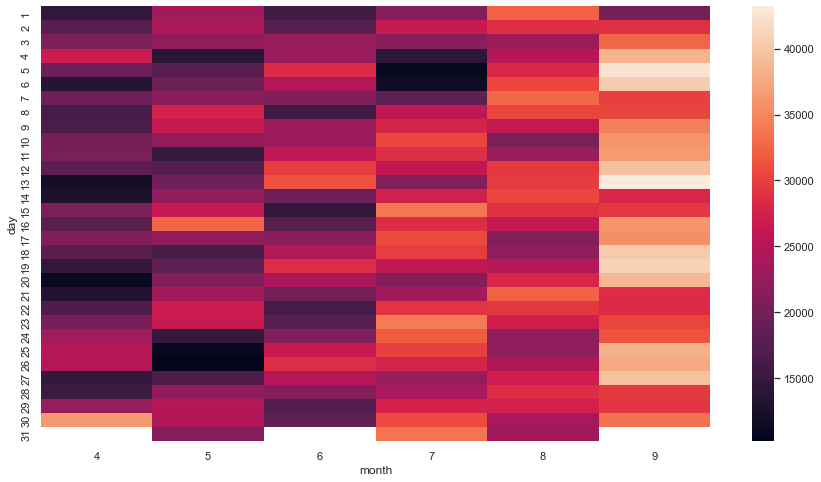

In [82]:
heatmap('day','month')

<AxesSubplot:xlabel='month', ylabel='weekday'>

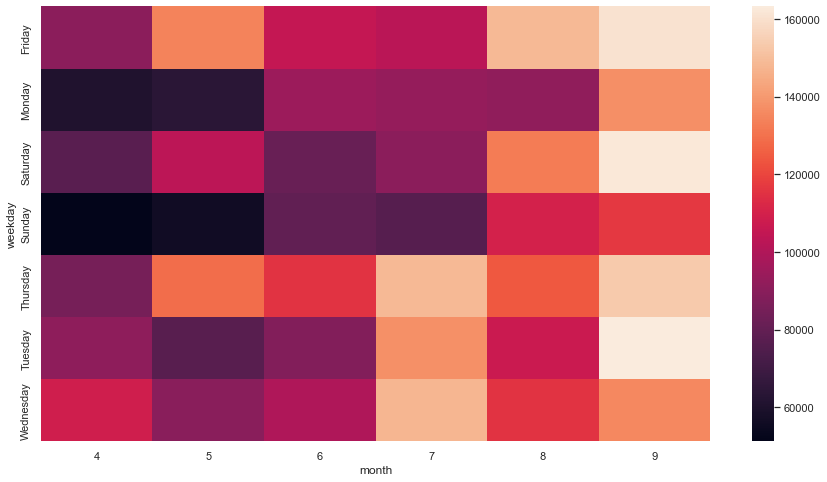

In [83]:
heatmap('weekday','month')

> #### Analysis of Location data points.

(40.6, 41.0)

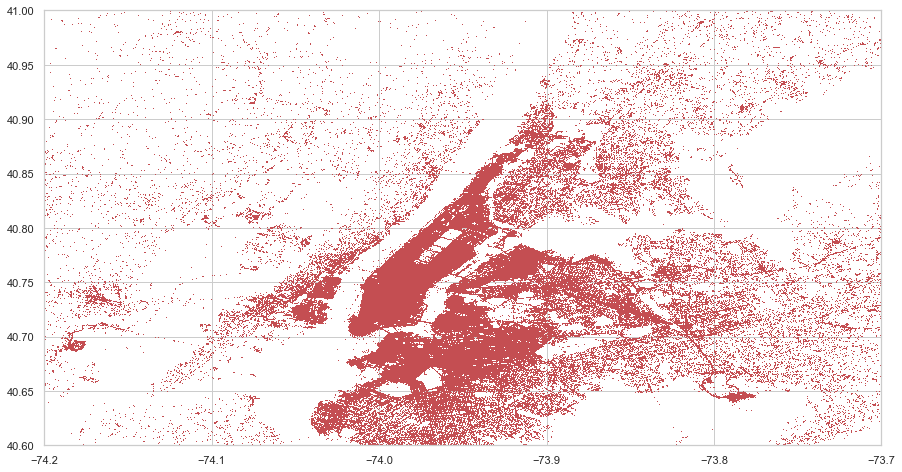

In [84]:
plt.figure(figsize=(15,8))

plt.plot(df['Lon'], df['Lat'],'r+', ms=0.5)
plt.xlim(-74.2, -73.7)
plt.ylim(40.6,41)

_We can see a number of hot spots here. Midtown Manhattan is clearly a huge bright spot.
& these are made from Midtown to Lower Manhattan.
Followed by Upper Manhattan and the Heights of Brooklyn._

> ##### perform Spatial Analysis using heatmap to get a clear cut of Rush on Sunday(Weekend).

In [85]:
df_out=df[df['weekday']=='Sunday']
df_out.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
6965,2014-04-06 00:00:00,40.6547,-74.3033,B02512,Sunday,6,0,4,0
6966,2014-04-06 00:00:00,40.7356,-74.0006,B02512,Sunday,6,0,4,0
6967,2014-04-06 00:00:00,40.7421,-74.0041,B02512,Sunday,6,0,4,0
6968,2014-04-06 00:00:00,40.7401,-74.0053,B02512,Sunday,6,0,4,0
6969,2014-04-06 00:01:00,40.7368,-73.9877,B02512,Sunday,6,1,4,0


In [86]:
df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()

,Lat,Lon,weekday
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [87]:
import folium
from folium.plugins import HeatMap
basemap=folium.Map()

In [88]:
HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
basemap

> #### Lets create a function for a specific day.

In [89]:
def plot(df,day):
    df_out=df[df['weekday']==day]
    df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=20,radius=15).add_to(basemap)
    return basemap

In [90]:
plot(df,'Sunday')

> #### Analysis of Jan-June uber_15.

In [92]:
uber_15 = pd.read_csv(r'C:/Users/FiBer-Tech/Desktop/practice/uber_data/uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv', encoding='utf-8')

In [93]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [94]:
#Checking the minimum date in the uber_15
uber_15['Pickup_date'].min()

'2015-01-01 00:00:05'

In [95]:
#Checking the maximum date in the uber_15
uber_15['Pickup_date'].max()

'2015-06-30 23:59:00'

In [96]:
uber_15['Pickup_date'] =  pd.to_datetime(uber_15['Pickup_date'], format='%Y-%m-%d %H:%M:%S')

In [97]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['minute']=uber_15['Pickup_date'].dt.minute
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['hour']=uber_15['Pickup_date'].dt.hour

In [98]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,5,9


> #### Analayse Uber pickups by the month in NYC.
_We can see that the number of Uber pickup has been steadily increasing throughout the first half of 2015 in NYC_

[Text(0.5, 0, 'Month'),
 Text(0, 0.5, 'Number Of Pickups'),
 Text(0.5, 1.0, 'pickups by the month in NYC')]

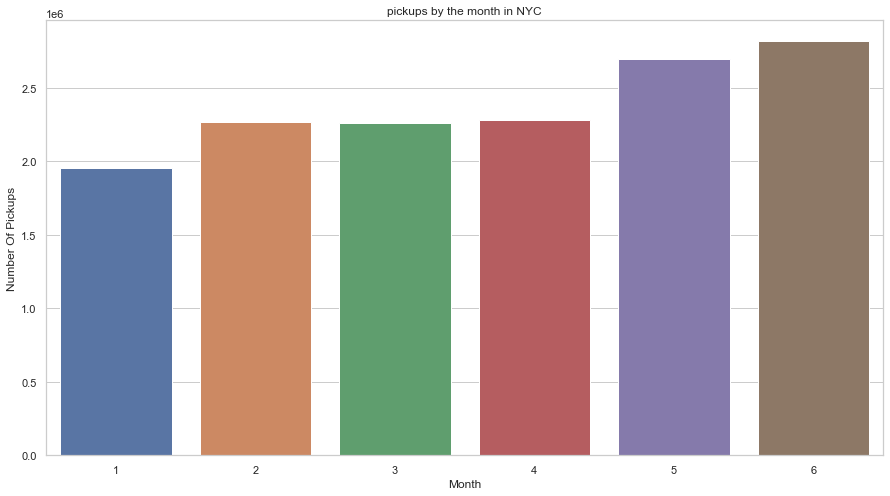

In [101]:
plt.figure(figsize=(15, 8))
ax = sns.barplot(x=uber_15['month'].value_counts().index,y=uber_15['month'].value_counts().values)
ax.set(xlabel = 'Month', ylabel = 'Number Of Pickups', title = 'pickups by the month in NYC')

> #### Analysing Rush in New york City.
_Interestingly, after the morning rush, the number of Uber pickups doesn't dip much throughout the rest of the morning and early afternoon. There is significantly more demand in the evening than the daytime. Let's investigate to see if there's a difference in hourly pattern for different days of the week._

C:\Users\FiBer-Tech\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


NameError: name 'tick' is not defined

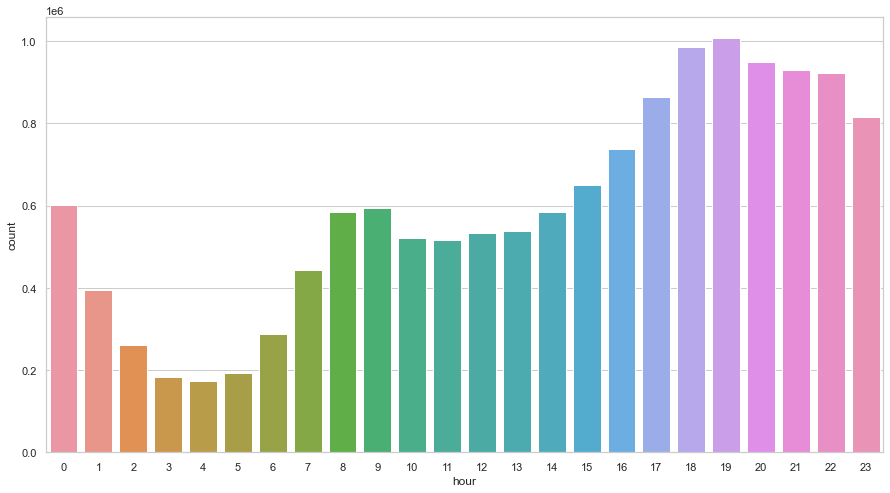

In [102]:
plt.figure(figsize=(15, 8))
ax=sns.countplot(uber_15['hour'])
ax.yaxis.set_major_formatter(tick.FormatStrFormatter('%.0f'))

> #### Analysing In-Depth Analysis of Rush in New york City Day & hour wise.

In [103]:
uber_15.groupby(['weekday', 'hour'])['Pickup_date'].count()

weekday    hour
Friday     0        85939
           1        46616
           2        28102
           3        19518
           4        23575
                    ...  
Wednesday  19      143751
           20      136003
           21      133993
           22      127026
           23       99490
Name: Pickup_date, Length: 168, dtype: int64

In [104]:
uber_15.groupby(['weekday', 'hour'])['Pickup_date'].count().reset_index()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575
...,...,...,...
163,Wednesday,19,143751
164,Wednesday,20,136003
165,Wednesday,21,133993
166,Wednesday,22,127026


In [105]:
summary=uber_15.groupby(['weekday', 'hour'])['Pickup_date'].count().reset_index()

In [106]:
summary=summary.rename(columns = {'Pickup_date':'Counts'})
summary

,weekday,hour,Counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575
...,...,...,...
163,Wednesday,19,143751
164,Wednesday,20,136003
165,Wednesday,21,133993
166,Wednesday,22,127026


<AxesSubplot:xlabel='hour', ylabel='Counts'>

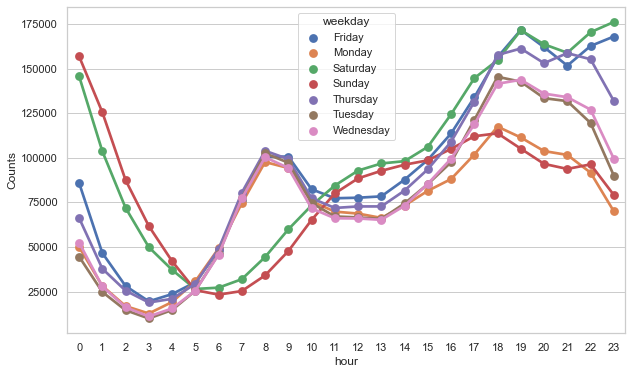

In [107]:
plt.figure(figsize=(10,6))
sns.pointplot(x="hour", y="Counts", hue="weekday", data=summary)

## Loading Uber-Jan-Feb-FOIL.csv.

In [108]:
uber_foil = pd.read_csv(r'C:/Users/FiBer-Tech/Desktop/practice/uber_data/uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv', encoding='utf-8')

In [109]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [110]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

>##### seems to have more number of Active Vehicles in B02764.

<AxesSubplot:xlabel='dispatching_base_number', ylabel='active_vehicles'>

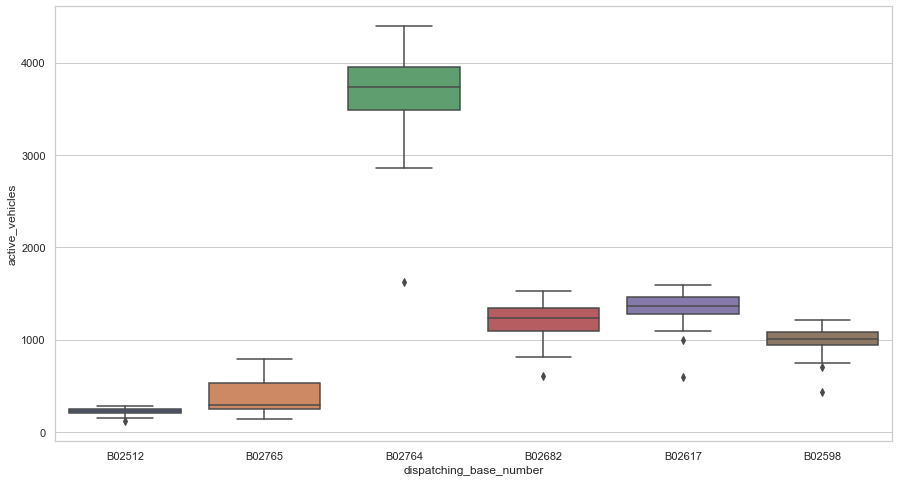

In [111]:
plt.figure(figsize=(15, 8))
sns.boxplot(x = 'dispatching_base_number', y = 'active_vehicles', data = uber_foil)

<AxesSubplot:xlabel='dispatching_base_number', ylabel='trips'>

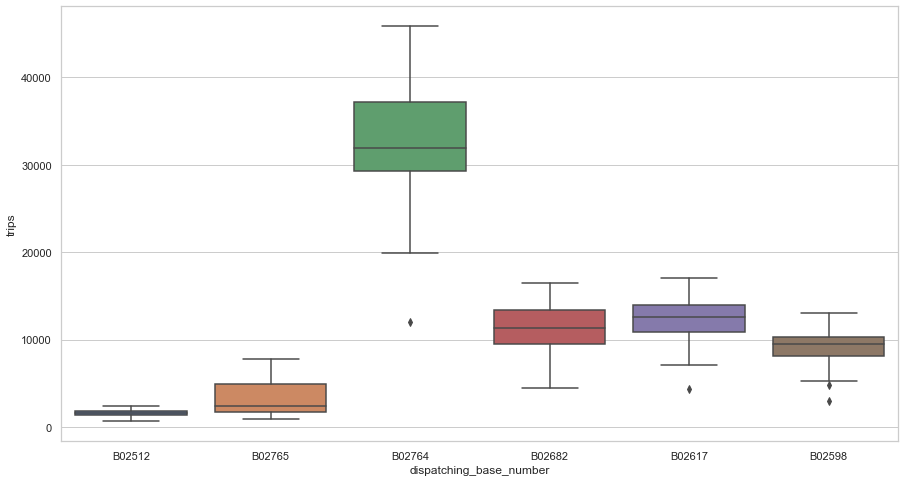

In [112]:
plt.figure(figsize=(15, 8))
sns.boxplot(x = 'dispatching_base_number', y = 'trips', data = uber_foil)

In [113]:
# Finding the ratio of trips/active_vehicles
uber_foil['trips/vehicle'] = uber_foil['trips']/uber_foil['active_vehicles']

In [114]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


In [115]:
uber_foil.set_index('date')

,dispatching_base_number,active_vehicles,trips,trips/vehicle
date,,,,
1/1/2015,B02512,190,1132,5.957895
1/1/2015,B02765,225,1765,7.844444
1/1/2015,B02764,3427,29421,8.585060
1/1/2015,B02682,945,7679,8.125926
1/1/2015,B02617,1228,9537,7.766287
...,...,...,...,...
2/28/2015,B02764,3952,39812,10.073887
2/28/2015,B02617,1372,14022,10.220117
2/28/2015,B02682,1386,14472,10.441558


> #### how Average trips/vehicle inc/decreases with dates with each of base umber?

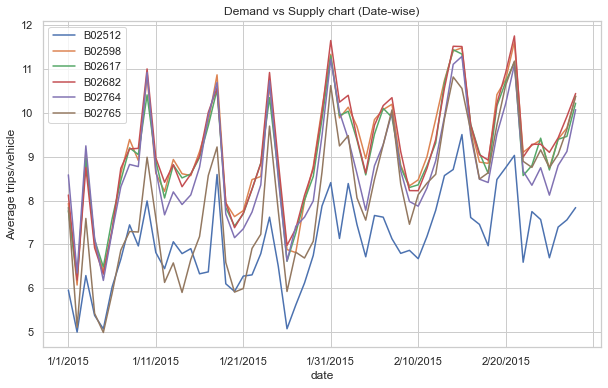

In [116]:
plt.figure(figsize=(10,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('Average trips/vehicle')
plt.title('Demand vs Supply chart (Date-wise)')
plt.legend()